In [17]:
import numpy as np
import argparse
from path import Path
import matplotlib.pyplot as plt
import glob
import subprocess
import pickle
import PIL as p
import csv
from utils.score_utils import mean_score, std_score
from IPython.display import display

import logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(name)s - %(levelname)s - %(message)s')
logger = logging.getLogger()

doms = glob.glob("/nn-images/images_split_by_domain/domains/*")

### Build scores and paths from pickles

In [2]:
pickles = glob.glob('/nn-images/image_scores/*')
counter = 0
for p in pickles:
    temp = pickle.load(open(p, "rb"))
    tas, tp = temp
    if counter == 0:
        act_scores = tas
        paths = tp
    else:
        act_scores = np.vstack((act_scores, tas))
        paths += tp
    counter += 1
#scores = pickle.load(open("/nn-images/image_scores/scores.subset.pkl", "rb"))
print(len(paths))
print(act_scores.shape)

807324
(807324, 10)


In [3]:
img_dct = pickle.load(open("image_dct.picke", "rb"))

In [4]:
ims = pickle.load(open("ims", "rb"))

In [5]:
influencer_mapping = pickle.load(open("influencer_mapping.pickle", "rb"))
rev_influencer_mapping = pickle.load(open("rev_influencer_mapping.pickle", "rb"))

In [15]:
def generate_scores(scores, paths, im):
    std_dev_count = 0
    xs_count = 0
    ds_count = 0
    
    # final score dct
    inf_scores = {}
    score_dct = {}
    dom_dct = {}
    
    # link scores to paths
    for x in range(0, len(paths)):
        score_dct[paths[x]] = mean_score(scores[x])
    
    # aggregate over domains
    for k,v in score_dct.items():
        d = img_dct[k] # get domain
        if d not in dom_dct.keys(): # build list of scores
            dom_dct[d] = [v]
        else:
            dom_dct[d].append(v)
    
    # build dictionaries of mean and stdev for each influencer
    means = {k : np.mean(np.asarray(v)) for k,v in dom_dct.items()}
    stdevs = {k : np.std(np.asarray(v)) for k,v in dom_dct.items()}
    dom_list = list(dom_dct.keys())
    
    # remove scores below 3.5 and also outliers
    for d in dom_list:
        try:
            infs = im[d] #get influencers tied to this domain
            for inf in infs:
                if inf not in inf_scores.keys():
                    inf_scores[inf] = []
                dscores = dom_dct[d]
                for ds in dscores:
                    top_cutoff = means[d] + 3*stdevs[d]
                    bottom_cutoff = means[d] - 3*stdevs[d]
                    if ds > 3.5:
                        if ds < top_cutoff and ds > bottom_cutoff:
                            ds_count += 1
                            inf_scores[inf].append(ds)
                        else:
                            std_dev_count += 1
                    else:
                        xs_count += 1
        except KeyError:
            logger.info(f'KeyError with {d}')
    r_list = [] # record domains to remove
    for i in inf_scores.keys():
        if len(inf_scores[i]) > 9:
            inf_scores[i] = np.mean(np.asarray(inf_scores[i]))
        else:
            r_list.append(i)
            logger.info(f'Below lengths limit for influencer {i}')
    for r in r_list:
        del inf_scores[r]
    print("Stdev: " + str(std_dev_count))
    print("Xs count: " + str(xs_count))
    print("Ds count: " + str(ds_count))
    print("Number removed: " + str(len(r_list)))
    return inf_scores

In [7]:
isc = generate_scores(act_scores, paths, influencer_mapping)

2018-08-31 14:57:19,642 - root - INFO - Below lengths limit for influencer 3387
2018-08-31 14:57:19,645 - root - INFO - Below lengths limit for influencer 9577
2018-08-31 14:57:19,648 - root - INFO - Below lengths limit for influencer 7791
2018-08-31 14:57:19,653 - root - INFO - Below lengths limit for influencer 602
2018-08-31 14:57:19,659 - root - INFO - Below lengths limit for influencer 7320
2018-08-31 14:57:19,664 - root - INFO - Below lengths limit for influencer 4020
2018-08-31 14:57:19,668 - root - INFO - Below lengths limit for influencer 5802
2018-08-31 14:57:19,671 - root - INFO - Below lengths limit for influencer 7874
2018-08-31 14:57:19,673 - root - INFO - Below lengths limit for influencer 2748
2018-08-31 14:57:19,674 - root - INFO - Below lengths limit for influencer 5831
2018-08-31 14:57:19,679 - root - INFO - Below lengths limit for influencer 9736
2018-08-31 14:57:19,681 - root - INFO - Below lengths limit for influencer 1341
2018-08-31 14:57:19,685 - root - INFO - B

Stdev: 3780
Xs count: 41
Ds count: 882508
Number removed: 39


In [8]:
sorted_isc = sorted((value, key) for (key,value) in isc.items())    

In [9]:
len(sorted_isc)

3823

In [10]:
sorted_isc[100:110]

[(5.0528446145137424, 3947),
 (5.054275616781389, 174),
 (5.056422968927238, 3053),
 (5.056815907087487, 7851),
 (5.057553495618736, 2585),
 (5.062419893918559, 2228),
 (5.063394090011051, 5427),
 (5.064443601115437, 5746),
 (5.064739122736053, 9163),
 (5.06501833881474, 3471)]

In [11]:
val_i = rev_influencer_mapping[174][0]
counter = 0

In [12]:
val_i

'confidentfoundation.com'

In [13]:
imgs = glob.glob('/nn-images/images_split_by_domain/domains/' + val_i + '/*')
print(len(imgs))

59


In [ ]:
counter = 0

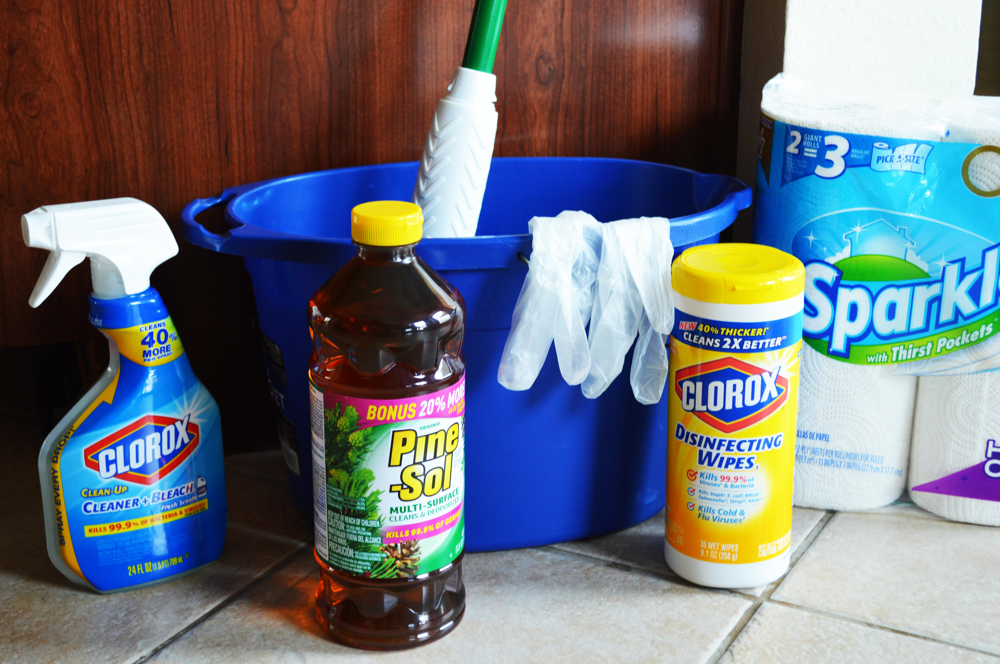

In [23]:
i = p.Image.open(imgs[counter])
counter += 1
display(i)

In [501]:
means[val_i]

5.309311203489145

In [502]:
np.std(np.asarray(dom_dct[val_i]))

0.3850621171882547

(array([ 2.,  2.,  3.,  8., 17., 23., 14., 16., 14.,  2.]),
 array([4.16604903, 4.36158961, 4.5571302 , 4.75267078, 4.94821137,
        5.14375195, 5.33929254, 5.53483312, 5.73037371, 5.92591429,
        6.12145488]),
 <a list of 10 Patch objects>)

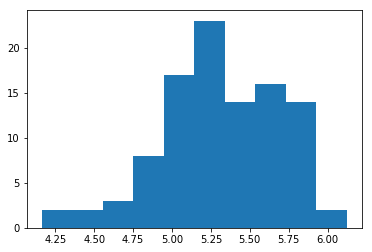

In [500]:
plt.hist( dom_dct[val_i])

In [372]:
# with open("csv_file", "w", newline='') as csvfile:
#     line_count = 0
#     cw = csv.writer(csvfile, delimiter=',',
#                             quotechar='"', quoting=csv.QUOTE_MINIMAL)
#     for r in range(0, len(sorted_isc)):
#         sc, inf_id = sorted_isc[r]
#         cw.writerow([inf_id,sc*100/maxval])
#         line_count +=1
# print(line_count)

3823


In [503]:
import pandas as pd
df = pd.DataFrame(sorted_isc, columns=['score', 'influencer_id'])
df.loc[:, 'score'] = df.loc[:, 'score'].rank(pct=True) * 100
df.to_csv('csv_file', header=False, index=False, columns=['influencer_id', 'score'])